# AirBnB Data Analysis

AirBnB is a popular home-sharing platform that brings together the comfort of home far away from home. Hosts list their properties on airbnb at resonable rates and people travelling can experience the true essence of the place in these homes.

We use the AirBnB data from Barcelona for our analysis in this notebook. Based on our evaluation, we derive interesting insights from this data and try to answer some questions that you may be having before your next trip.

We also employ machine learning to predict the prices of airbnb homes and try to understand the factors that affect them.

In [ ]:
# import important libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
%matplotlib inline
import plotly.offline as pyo
pyo.init_notebook_mode()

pd.set_option("display.max_rows", 100)

In [79]:
# graphing libraries

import plotly
import plotly_express as px
import plotly.graph_objects as go

We got this data from http://insideairbnb.com/get-the-data.html. This data was scraped on 12th October 2020 and consists of three datasets.

1. Calender: Contains details about the availability of homes, their price and the minimum and maximum stay duration.
2. Listings: This dataset contains comprehensive information about the listed properties and the hosts that rent them out.
3. Reviews: This dataset contains the reviews given by the users for the listed homes.

In [2824]:
# load all data
calender = pd.read_csv('data/calendar.csv')
listings = pd.read_csv('data/listings.csv')
reviews = pd.read_csv('data/reviews.csv')

In [19]:
# get data shapes
print(calender.shape)
print(listings.shape)
print(reviews.shape)

(7262779, 7)
(19896, 74)
(639522, 6)


In [17]:
calender.head()

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,353640,2020-10-17,f,$80.00,$80.00,2.0,1125.0
1,21974,2020-10-13,f,$55.00,$55.00,3.0,90.0
2,21974,2020-10-14,f,$55.00,$55.00,3.0,90.0
3,21974,2020-10-15,f,$55.00,$55.00,3.0,90.0
4,21974,2020-10-16,f,$55.00,$55.00,3.0,90.0


In [2642]:
listings.head()

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,21974,https://www.airbnb.com/rooms/21974,20201012033127,2020-10-13,Comf. double room/private bathroom,It is private double room with private bathroo...,NaN,https://a0.muscache.com/pictures/8e7c8694-f5ea...,73163,https://www.airbnb.com/users/show/73163,Andres,2010-01-24,"Barcelona, Catalonia, Spain","Hello I am a Professional designer, a traveler...",within a few hours,100%,91%,f,https://a0.muscache.com/im/pictures/user/9cbe7...,https://a0.muscache.com/im/pictures/user/9cbe7...,El Gòtic,3.0,3.0,"['email', 'phone', 'reviews', 'manual_offline'...",t,t,NaN,el Barri Gòtic,Ciutat Vella,41.37973,2.17631,Private room in apartment,Private room,2,NaN,1 shared bath,1.0,1.0,"[""Kitchen"", ""Essentials"", ""Cable TV"", ""Air con...",$55.00,3,90,3.0,3.0,90.0,90.0,3.0,90.0,NaN,t,4,23,49,139,2020-10-13,2,0,0,2017-05-16,2017-11-06,100.0,10.0,10.0,10.0,10.0,10.0,10.0,HUTB-120440,f,3,1,2,0,0.05
1,23197,https://www.airbnb.com/rooms/23197,20201012033127,2020-10-17,Forum DeLuxe 5 mins Walk To CCIB Center & Sea★,"Beautiful apartment, large terrace, 5 minutes ...",Strategically located in the Parc del Fòrum ar...,https://a0.muscache.com/pictures/738532/806da1...,90417,https://www.airbnb.com/users/show/90417,Etain (Marnie),2010-03-09,"Catalonia, Spain","Hi. I'm Etain, though everyone calls me by my...",within an hour,100%,100%,t,https://a0.muscache.com/im/users/90417/profile...,https://a0.muscache.com/im/users/90417/profile...,El Besòs i el Maresme,6.0,6.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...",t,t,"Sant Adria de Besos, Barcelona, Spain",el Besòs i el Maresme,Sant Martí,41.41291,2.22063,Entire apartment,Entire home/apt,6,NaN,2 baths,3.0,5.0,"[""Bed linens"", ""Cooking basics"", ""Heating"", ""L...",$180.00,3,1125,3.0,4.0,1125.0,1125.0,3.1,1125.0,NaN,t,30,60,90,358,2020-10-17,52,1,0,2011-03-15,2019-12-15,95.0,10.0,10.0,10.0,10.0,9.0,9.0,HUTB-005057,t,2,2,0,0,0.45
2,32711,https://www.airbnb.com/rooms/32711,20201012033127,2020-10-15,Sagrada Familia area - Còrsega 1,A lovely two bedroom apartment only 250 m from...,What's nearby <br />This apartment is located...,https://a0.muscache.com/pictures/357b25e4-f414...,135703,https://www.airbnb.com/users/show/135703,Nick,2010-05-31,"Barcelona, Catalonia, Spain",I'm Nick your English host in Barcelona.\r\n\r...,within an hour,100%,98%,f,https://a0.muscache.com/im/users/135703/profil...,https://a0.muscache.com/im/users/135703/profil...,Camp d'en Grassot i Gràcia Nova,5.0,5.0,"['email', 'phone', 'facebook', 'reviews', 'jum...",t,t,"Barcelona, Catalonia, Spain",el Camp d'en Grassot i Gràcia Nova,Gràcia,41.40566,2.17015,Entire apartment,Entire home/apt,6,NaN,1.5 baths,2.0,3.0,"[""Elevator"", ""Hot water"", ""H

In [2643]:
reviews.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,21974,152431809,2017-05-16,128118341,Dries,great location and excellent host!
1,21974,209855799,2017-11-06,21929246,Casa De La Unica,The Apartment was (Website hidden by Airbnb) N...
2,23197,199839,2011-03-15,409630,Tim,We (5 friends) were staying for a conference i...
3,23197,857673,2012-01-11,1594062,Aaron,The host canceled my reservation 138 days befo...
4,23197,40030652,2015-07-27,4933115,Thomas,We had a nice stay at the apartment. It is a 1...


# Data cleaning and Preprocessing

First let's find out the categorical and numerical columns in our dataset. We will be working with the listings data here.

In [2647]:
numerical = listings.select_dtypes(include=['int', 'float']).columns
categorical = listings.select_dtypes(include=['object']).columns
print("Numerical columns:", numerical)
print("Categorical columns:", categorical)

Numerical columns: Index(['id', 'scrape_id', 'host_id', 'host_listings_count',
       'host_total_listings_count', 'latitude', 'longitude', 'accommodates',
       'bathrooms', 'bedrooms', 'beds', 'minimum_nights', 'maximum_nights',
       'minimum_minimum_nights', 'maximum_minimum_nights',
       'minimum_maximum_nights', 'maximum_maximum_nights',
       'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm', 'calendar_updated',
       'availability_30', 'availability_60', 'availability_90',
       'availability_365', 'number_of_reviews', 'number_of_reviews_ltm',
       'number_of_reviews_l30d', 'review_scores_rating',
       'review_scores_accuracy', 'review_scores_cleanliness',
       'review_scores_checkin', 'review_scores_communication',
       'review_scores_location', 'review_scores_value',
       'calculated_host_listings_count',
       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',
       'calculated_host_listings_count_shared_

In [107]:
# check nulls
listings.isna().sum().sort_values(ascending=False)

bathrooms                                       19896
calendar_updated                                19896
neighborhood_overview                            7754
neighbourhood                                    7754
host_about                                       7555
license                                          7507
host_response_time                               7487
host_response_rate                               7487
review_scores_checkin                            6142
review_scores_value                              6142
review_scores_location                           6141
review_scores_accuracy                           6138
review_scores_cleanliness                        6137
review_scores_communication                      6136
review_scores_rating                             6123
last_review                                      5877
first_review                                     5877
reviews_per_month                                5877
host_neighbourhood          

Find out columns with more than 99% nulls and drop them as they are of no significance for us.

In [128]:
listings.columns[listings.isna().sum()/len(listings)>0.99]

Index(['bathrooms', 'calendar_updated'], dtype='object')

In [2758]:
# so we can drop bathrooms and calender_upadted cols
# all values similar; no use
df = listings.drop(['bathrooms', 'calendar_updated', 'has_availability'], axis=1)

Some other columns containing ids and urls are also not needed for the price prediction and hence can be dropped.

Note: We will keep the 'id' column for now as it will be useful to grab and merge data from other sets.

In [2759]:
df = df.drop(['scrape_id', 'host_id', 'listing_url', 'last_scraped', 'host_url',
              'host_thumbnail_url', 'host_picture_url', 'picture_url'], axis=1)

There are also many columns providing information of the minimum and maximum nights stay at the place. We will only keep the 2 main columns of 'minimum_nights' and 'maximum_nights' and discard other variations.  

In [2760]:
cols_to_drop = ['minimum_minimum_nights', 'maximum_minimum_nights',
               'minimum_maximum_nights', 'maximum_maximum_nights', 'minimum_nights_avg_ntm',
               'maximum_nights_avg_ntm']
df.drop(cols_to_drop, axis=1, inplace=True)

We will start by processing the categorical columns.

1. host_is_superhost - Whether a host is superhost or not. Superhosts are top-ranked and most experienced hosts.
2. host_identity_verified - Whether or not the identity of the host is verified on airbnb platform.
3. host_has_profile_pic - Does the host have a profile picture or not.
4. instant_bookable - Is the space instantly bookable or not.

The column values are given as 't' and 'f'. We identify the 4 potentially important columns.

In [2761]:
# process categorical vars with dummies
df['host_is_superhost'] = pd.get_dummies(df['host_is_superhost'])['t']
df['host_identity_verified'] = pd.get_dummies(df['host_identity_verified'])['t']
df['host_has_profile_pic'] = pd.get_dummies(df['host_has_profile_pic'])['t']
df['instant_bookable'] = pd.get_dummies(df['instant_bookable'])['t']

<b> host_since: </b> Datetime column telling us when the host joined the platform.

We derive a new column conveying the number of days since the host is active on the platform. We subtract the values in the host_since column with the date when the data was scraped. In our case, this is 12 October, 2020.

In [2762]:
# host since column
from datetime import datetime

df.host_since = pd.to_datetime(df.host_since)
df['host_since_days'] = (datetime(2020, 10, 12) - df.host_since).astype('timedelta64[D]')
# fill null values with median
df.host_since_days.fillna(df.host_since_days.median(), inplace=True)

In [2763]:
df.host_since.min()

Timestamp('2008-09-19 00:00:00')

<b> host response time </b>: Categorical column telling us how fast the host responds to the user. We will one-hot encode this column.

In [2764]:
df.host_response_time.value_counts()

within an hour        6299
within a few hours    3026
within a day          2037
a few days or more    1047
Name: host_response_time, dtype: int64

In [2765]:
df.host_response_time.fillna('unknown', inplace=True)

In [2766]:
col = 'host_response_time'
df = pd.concat([df.drop([col], axis=1), pd.get_dummies(df[col], drop_first=True, prefix=col)], axis=1)

<b> host acceptance rate </b> : How often does the host accept the user booking.

In [2767]:
sum(df.host_acceptance_rate=='100%')

7328

In [2768]:
sum(df.host_acceptance_rate<'50%')

8579

In [2769]:
df.host_acceptance_rate.value_counts()[:10]

100%    7328
99%     1134
98%      959
0%       513
97%      464
96%      450
93%      402
95%      385
50%      306
92%      255
Name: host_acceptance_rate, dtype: int64

In [2770]:
df.host_acceptance_rate = df.host_acceptance_rate.str[:-1].astype('float64')
print('Mean host acceptance rate:', df.host_acceptance_rate.mean())

Mean host acceptance rate: 87.43942543942543


Since the values vary a lot and most hosts show a higher acceptance rate, we will bin the values into 4 categories to get a clear view of the distribution.

In [2771]:
# function for binning values
def bin_column(col, bins, labels, na_label='unknown'):
    """
    Takes in a column name, bin cut points and labels, replaces the original column with a
    binned version, and replaces nulls (with 'unknown' if unspecified).
    """
    df[col] = pd.cut(df[col], bins=bins, labels=labels, include_lowest=True)
    df[col] = df[col].astype('str')
    df[col].fillna(na_label, inplace=True)

In [2772]:
col = 'host_acceptance_rate'
bin_column(col,
            bins=[0, 50, 90, 99, 100], labels=['0-49%', '50-89%', '90-99%', '100%'],
            na_label='unknown')

In [2773]:
df.host_acceptance_rate.value_counts()

100%      7328
90-99%    4457
nan       4023
50-89%    2518
0-49%     1570
Name: host_acceptance_rate, dtype: int64

In [2774]:
# one hot encode the categories
df = pd.concat([df.drop([col], axis=1), pd.get_dummies(df[col], drop_first=True, prefix=col)], axis=1)

<b> bathrooms_text </b>: Description of the bathrooms in the home.

We will extract number of bathrooms from the bathroom text.

In [2775]:
df.bathrooms_text.isna().sum()

9

In [2776]:
# dropping rows where bath info missing
df.dropna(subset=['bathrooms_text'], inplace=True)

In [2777]:
df.bathrooms_text.value_counts()[:10]

1 bath              7161
1 shared bath       4680
2 baths             2903
1 private bath      1440
1.5 shared baths    1026
1.5 baths            902
2 shared baths       814
3 baths              253
2.5 baths            142
2.5 shared baths      83
Name: bathrooms_text, dtype: int64

In [2778]:
# extract no of bathrooms from text
import sys

def get_bath_counts(col):
    try:
        if 'half' in col or 'Half' in col:
            c = 0.5
        else:
            c = re.findall(r'\d+', col)[0]
    except:
        print(col)
        print(sys.exc_info()[0])
    return c

df['num_bathrooms'] = pd.to_numeric(df['bathrooms_text'].apply(lambda x: get_bath_counts(x)))

<b>room_type :</b> Whether the space is private, shared, hotel, apartment or other. <br>
<b>neighbourhood_group_cleansed :</b> The neighbourhood of the listed property.

We will one-hot encode these as well.

In [2779]:
df['room_type'].value_counts()

Private room       9873
Entire home/apt    9437
Hotel room          364
Shared room         213
Name: room_type, dtype: int64

In [2780]:
df = pd.concat([df.drop(['room_type'], axis=1), pd.get_dummies(df['room_type'], drop_first=True)], axis=1)

In [2781]:
df['neighbourhood_group_cleansed'].value_counts()

Eixample               6699
Ciutat Vella           4746
Sants-Montjuïc         2260
Sant Martí             2027
Gràcia                 1668
Sarrià-Sant Gervasi     840
Horta-Guinardó          630
Les Corts               420
Sant Andreu             329
Nou Barris              268
Name: neighbourhood_group_cleansed, dtype: int64

In [2782]:
df = pd.concat([df.drop(['neighbourhood_group_cleansed'], axis=1), pd.get_dummies(df['neighbourhood_group_cleansed'], drop_first=True)], axis=1)

<b>amenities: </b> The amenities provided at the place.

In [2783]:
import ast
from collections import Counter

am_list=[]
for x in df.amenities.values:
    am_list.extend(ast.literal_eval(x))

c = Counter(am_list)
most_freq = [w for w,c in c.most_common()[:20]]
most_freq

['Wifi',
 'Essentials',
 'Kitchen',
 'Hangers',
 'Washer',
 'Heating',
 'Hair dryer',
 'Iron',
 'TV',
 'Hot water',
 'Air conditioning',
 'Shampoo',
 'Laptop-friendly workspace',
 'Elevator',
 'Dishes and silverware',
 'Refrigerator',
 'Microwave',
 'Coffee maker',
 'Cooking basics',
 'Bed linens']

We will add columns for all these important amenities to our dataframe.

In [2784]:
# include potential important amenities
most_freq.append('balcony')

def amenity(col, amenity):
    try:
        if amenity in col:
            c = 1
        else:
            c = 0
    except:
        print(col)
        print(sys.exc_info()[0])
    return c

In [2785]:
# add these to dataframe
for col in most_freq:
    df['has_'+col] = pd.to_numeric(df['amenities'].apply(lambda x: amenity(x, col)))

<b>property_type:</b> describes the kind of property. eg. private, shared, entice space, etc.

In [2786]:
df.property_type.value_counts()

Private room in apartment             8332
Entire apartment                      8282
Entire loft                            339
Private room in house                  330
Entire serviced apartment              283
Private room in condominium            265
Entire condominium                     258
Room in boutique hotel                 215
Private room in serviced apartment     152
Private room in bed and breakfast      134
Room in hotel                          125
Private room in hostel                 109
Private room in guest suite            107
Private room in loft                    97
Room in serviced apartment              87
Room in hostel                          85
Shared room in hostel                   82
Entire house                            79
Shared room in apartment                74
Entire guest suite                      49
Boat                                    40
Private room in guesthouse              34
Shared room in bed and breakfast        32
Private roo

We bin the property types into 4 categories: private_room, shared_room, entire_space and other.

In [2787]:
def bin_property_type(col):
    
    if 'Private' in col:
        val='private_room'
    elif 'Shared' in col:
        val='shared_room'
    elif 'Entire' in col:
        val='entire_space'
    elif 'hotel' in col or 'aparthotel' in col:
        val='hotel'
    elif 'Private' not in col or 'Shared' not in col or 'Entire' not in col or 'hotel' not in col or 'aparthotel' not in col:
        val='other'

    return val

df['property_type'] = df.property_type.apply(lambda x : bin_property_type(x))

In [2788]:
df.property_type.value_counts()

private_room    9678
entire_space    9372
hotel            368
other            256
shared_room      213
Name: property_type, dtype: int64

One hot encode the properties.

In [2789]:
df = pd.concat([df.drop(['property_type'], axis=1), pd.get_dummies(df['property_type'], drop_first=True)], axis=1)

We will now look at the <b>numerical columns</b>.

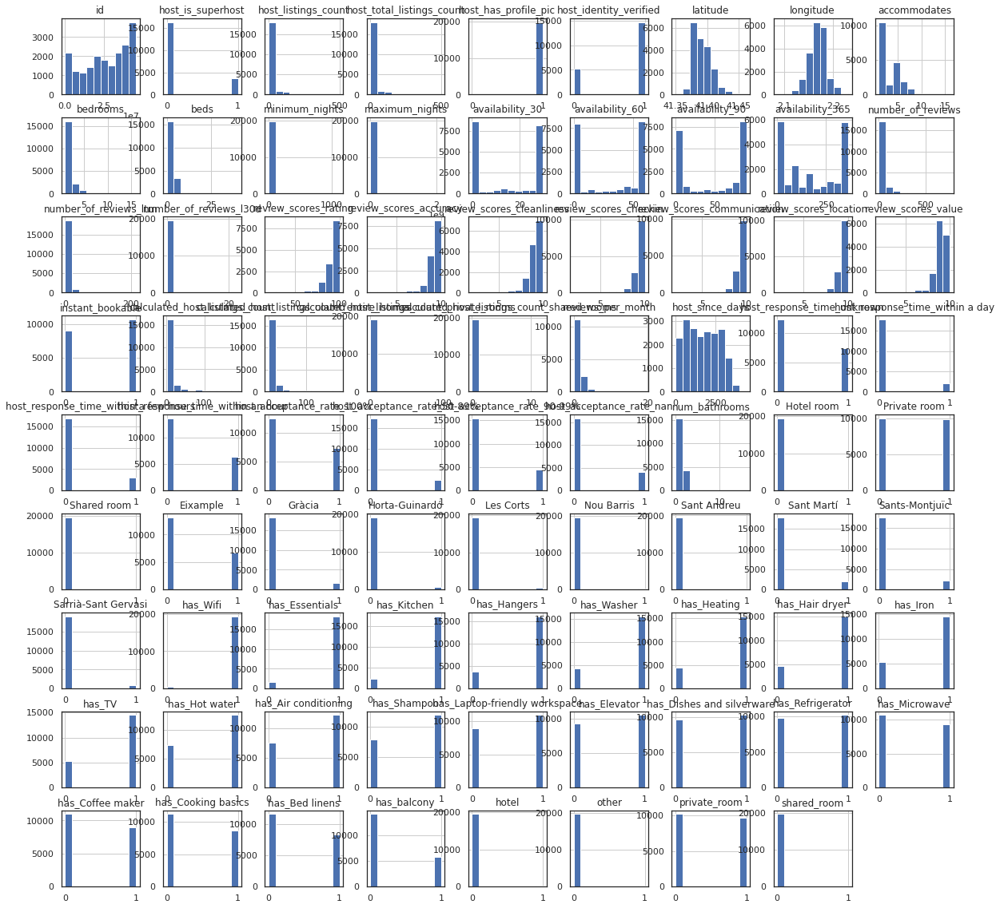

In [2790]:
df.hist(figsize=(20,20));

Handle review rating columns.

1. review_scores_rating: User review rating (0-100).
2. review_scores_accuracy: Accuracy of review scores (0-10).
3. review_scores_cleanliness: Cleanliness review scores (0-10).
4. review_scores_checkin: Checkin rating (0-10).
5. review_scores_communication: Communication with host (0-10).
6. review_scores_location: Location rating (0-10).
7. review_scores_value: Overall review score (0-10).

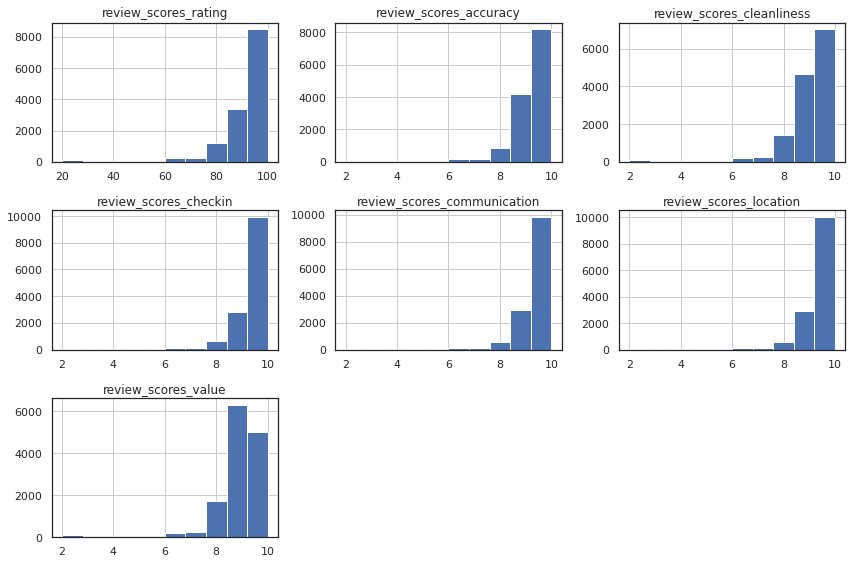

In [2791]:
# Checking the distributions of the review ratings columns
variables_to_plot = list(df.columns[df.columns.str.startswith("review_scores") == True])
fig = plt.figure(figsize=(12,8))
for i, var_name in enumerate(variables_to_plot):
    ax = fig.add_subplot(3,3,i+1)
    df[var_name].hist(bins=10,ax=ax)
    ax.set_title(var_name)
fig.tight_layout()
plt.show()

We will bin all the review ratings into distinct categories and one-hot encode them. The only exception is 'review_scores_accuracy' which will be used as it is. This is because it is a good predictor for the price as per our analysis.

In [2792]:
# Creating a list of all review columns that are scored out of 10
variables_to_plot.pop(0)
variables_to_plot.pop(0)

'review_scores_accuracy'

In [2793]:
# Binning for all columns scored out of 10
for col in variables_to_plot:
    bin_column(col,
               bins=[0, 8, 9, 10],
               labels=['0-8/10', '9/10', '10/10'],
               na_label='no reviews')

In [2794]:
df.review_scores_value.value_counts()

9/10      6323
nan       6135
10/10     5027
0-8/10    2402
Name: review_scores_value, dtype: int64

In [2795]:
# Binning column scored out of 100
bin_column('review_scores_rating',
           bins=[0, 80, 95, 100],
           labels=['0-79/100', '80-94/100', '95-100/100'],
           na_label='no reviews')

In [2796]:
df.review_scores_rating.value_counts()

80-94/100     6826
nan           6116
95-100/100    5469
0-79/100      1476
Name: review_scores_rating, dtype: int64

One hot encode the columns.

In [2797]:
for col in variables_to_plot:
    df = pd.concat([df.drop([col], axis=1), pd.get_dummies(df[col], drop_first=True, prefix=col)], axis=1)

In [2798]:
df = pd.concat([df.drop(['review_scores_rating'], axis=1), pd.get_dummies(df['review_scores_rating'], drop_first=True, prefix='review_scores_rating')], axis=1)

Handle important columns such as bedrooms, beds, accomadates. Fill NAN with mean/median.

<b> beds</b> : No. of beds at the place. <br>
<b> bedrooms</b> : No. of bedrooms at the place. <br>
<b> accomodates</b> : No. of people that can be accomodated at the place. <br>
<b> reviews_per_month</b> : No. of property reviews per month.

In [2799]:
df.bedrooms.value_counts()

1.0     12052
2.0      4011
3.0      2236
4.0       647
5.0       121
6.0        71
7.0        12
8.0        11
9.0         9
10.0        7
11.0        3
12.0        3
15.0        1
16.0        1
Name: bedrooms, dtype: int64

In [2800]:
df.beds.value_counts()

1.0     9095
2.0     3688
3.0     2506
4.0     1685
5.0      890
6.0      535
0.0      529
7.0      205
8.0      124
9.0       56
10.0      50
12.0      21
14.0      18
11.0      13
16.0      13
15.0      12
13.0       8
18.0       7
20.0       6
17.0       3
30.0       2
25.0       1
28.0       1
24.0       1
19.0       1
40.0       1
Name: beds, dtype: int64

In [2801]:
df.accommodates.value_counts()

2     7356
4     3563
1     3164
6     1918
3     1475
5     1123
8      540
7      299
10     161
9       94
16      72
12      66
14      25
11      14
15      10
13       7
Name: accommodates, dtype: int64

In [2802]:
print(df.bedrooms.isna().sum())
print(df.beds.isna().sum())
print(df.reviews_per_month.isna().sum())

702
416
5870


In [2803]:
# fill the nan values in these columns with the median value of the column

df['bedrooms'] = df['bedrooms'].fillna(df['bedrooms'].median())
df['beds'] = df['beds'].fillna(df['beds'].median())
df['reviews_per_month'] = df['reviews_per_month'].fillna(df['reviews_per_month'].median())

<b>host_listings_count</b> : Number of listings per host.<br>
We have one more column 'host_total_listings_count' that is similar to 'host_listings_count', so this can be dropped.

In [2804]:
sum((df.host_listings_count==df.host_total_listings_count)==False)

7

In [2805]:
df.drop(['host_total_listings_count'], axis=1, inplace=True)
df = df.dropna(subset=['host_listings_count'])

<b> NLP sentiment analysis based on user reviews </b> <br>

We used unsupervised machine learning to predict the sentiments of the users based on their reviews given in the reviews dataset. This is a separate task and thus has been done in a separate notebook that you can find in the folder. We get the sentiment scores for the listings and merge with our dataset here.

In [2806]:
sentiments = pd.read_csv('./data/id_sentiment.csv')
sentiments.rename(columns={'listing_id':'id', 'prediction':'sentiment'}, inplace=True)
sentiments.head()

,id,sentiment
0,21974.0,1.000000
1,23197.0,0.976744
2,32711.0,0.857143
3,34241.0,1.000000
4,34981.0,0.933884


In [2807]:
df = pd.merge(df, sentiments, on=['id'])

In [2808]:
# now we can drop the 'id' column
df.drop('id', axis=1, inplace=True)

We will now check numeric variables for skewness. If variables are skewed, we will use log transformation to process them.

In [2809]:
mask = df.dtypes == np.float
float_cols = df.columns[mask]
float_cols

Index(['host_listings_count', 'latitude', 'longitude', 'bedrooms', 'beds',
       'review_scores_accuracy', 'reviews_per_month', 'host_since_days',
       'num_bathrooms', 'sentiment'],
      dtype='object')

In [2810]:
# Create a list of float colums to check for skewing
mask = df.dtypes == np.float
float_cols = df.columns[mask]

skew_limit = 1 # define a limit above which we will log transform
skew_vals = df[float_cols].skew()

In [2811]:
# Showing the skewed columns
skew_cols = (skew_vals
             .sort_values(ascending=False)
             .to_frame()
             .rename(columns={0:'Skew'})
             .query('abs(Skew) > {}'.format(skew_limit)))

skew_cols

,Skew
host_listings_count,5.777265
num_bathrooms,3.813801
beds,2.399740
bedrooms,2.144206
reviews_per_month,2.119187
sentiment,-3.151544
review_scores_accuracy,-3.322532


Let's look at what happens to one of these features, when we apply np.log1p visually.

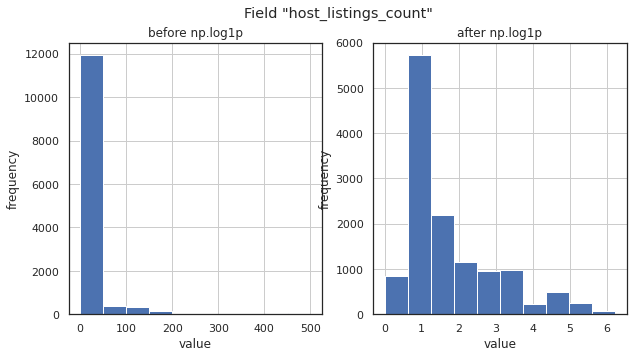

In [2812]:
# Choose a field
field = "host_listings_count"

# Create two "subplots" and a "figure" using matplotlib
fig, (ax_before, ax_after) = plt.subplots(1, 2, figsize=(10, 5))

# Create a histogram on the "ax_before" subplot
df[field].hist(ax=ax_before)

# Apply a log transformation (numpy syntax) to this column
df[field].apply(np.log1p).hist(ax=ax_after)

# Formatting of titles etc. for each subplot
ax_before.set(title='before np.log1p', ylabel='frequency', xlabel='value')
ax_after.set(title='after np.log1p', ylabel='frequency', xlabel='value')
fig.suptitle('Field "{}"'.format(field));

In [2813]:
# Perform the skew transformation:

for col in skew_cols.index.values:
    df[col] = df[col].apply(np.log1p)

<b>price:</b> The price of the property.

Process the price column from string to numeric. Also remove outliers based on the price. Naturally, the prices cannot take value of 0 and unreasonably high amounts.

In [2814]:
# process price data
# process = lambda col: col.replace('$', '')
import re 
import string

def process(col):
#     val = col.replace('$', '')
    col = col.translate(str.maketrans('', '', ','))
    val = re.findall(r'\d+', col)[0]

    return val

df['price'] = pd.to_numeric(df['price'].apply(lambda x: process(x)))

In [2815]:
import plotly.figure_factory as ff

group_labels = ['distplot']
fig = ff.create_distplot([df.price.values], group_labels)
fig.show()
plt.show()

In [2816]:
len(df[df.price>1000]) # 20 outliers having price more than 1000 dolllars

20

In [2817]:
len(df[df.price<10])

6

Since we have very less values below 10 and above 1000, we remove these listings.

In [2818]:
# remove outliers
df = df.loc[(df.price<1000) & (df.price>10)]

In [2819]:
group_labels = ['distplot']
fig = ff.create_distplot([df.price.values], group_labels)
fig.show()
plt.show()

In [2820]:
df.head()

,name,description,neighborhood_overview,host_url,host_name,host_since,host_location,host_about,host_response_rate,host_is_superhost,host_neighbourhood,host_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,latitude,longitude,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_accuracy,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,host_since_days,host_response_time_unknown,host_response_time_within a day,host_response_time_within a few hours,host_response_time_within an hour,...,Les Corts,Nou Barris,Sant Andreu,Sant Martí,Sants-Montjuïc,Sarrià-Sant Gervasi,has_Wifi,has_Essentials,has_Kitchen,has_Hangers,has_Washer,has_Heating,has_Hair dryer,has_Iron,has_TV,has_Hot water,has_Air conditioning,has_Shampoo,has_Laptop-friendly workspace,has_Elevator,has_Dishes and silverware,has_Refrigerator,has_Microwave,has_Coffee maker,has_Cooking basics,has_Bed linens,has_balcony,hotel,other,private_room,shared_room,review_scores_cleanliness_10/10,review_scores_cleanliness_9/10,review_scores_cleanliness_nan,review_scores_checkin_10/10,review_scores_checkin_9/10,review_scores_checkin_nan,review_scores_communication_10/10,review_scores_communication_9/10,review_scores_communication_nan,review_scores_location_10/10,review_scores_location_9/10,review_scores_location_nan,review_scores_value_10/10,review_scores_value_9/10,review_scores_value_nan,review_scores_rating_80-94/100,review_scores_rating_95-100/100,review_scores_rating_nan,sentiment
0,Comf. double room/private bathroom,It is private double room with private bathroo...,NaN,https://www.airbnb.com/users/show/73163,Andres,2010-01-24,"Barcelona, Catalonia, Spain","Hello I am a Professional designer, a traveler...",100%,0,El Gòtic,1.386294,"['email', 'phone', 'reviews', 'manual_offline'...",1,1,NaN,el Barri Gòtic,41.37973,2.17631,2,1 shared bath,0.693147,0.693147,"[""Kitchen"", ""Essentials"", ""Cable TV"", ""Air con...",55,3,90,4,23,49,139,2020-10-13,2,0,0,2017-05-16,2017-11-06,2.397895,HUTB-120440,0,3,1,2,0,0.048790,3914.0,0,0,1,0,...,0,0,0,0,0,0,1,1,1,0,1,1,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,1,0,0.693147
1,Forum DeLuxe 5 mins Walk To CCIB Center & Sea★,"Beautiful apartment, large terrace, 5 minutes ...",Strategically located in the Parc del Fòrum ar...,https://www.airbnb.com/users/show/90417,Etain (Marnie),2010-03-09,"Catalonia, Spain","Hi. I'm Etain, though everyone calls me by my...",100%,1,El Besòs i el Maresme,1.945910,"['email', 'phone', 'reviews', 'jumio', 'offlin...",1,1,"Sant Adria de Besos, Barcelona, Spain",el Besòs i el Maresme,41.41291,2.22063,6,2 baths,1.386294,1.791759,"[""Bed linens"", ""Cooking basics"", ""Heating"", ""L...",180,3,1125,30,60,90,358,2020-10-17,52,1,0,2011-03-15,2019-12-15,2.397895,HUTB-005057,1,2,2,0,0,0.371564,3870.0,0,0,0,1,...,0,0,0,1,0,0,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,0,0,0,0,1,0,0,1,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0.681451
2,Sagrada Familia area - Còrsega 1,A lovely two bedroom apartment only 250 m from...,What's nearby <br />This apartment is located...,https://www.airbnb.com/users/show/135703,Nick,2010-05-31,"Barcelona, Catalonia, Spain",I'm Nick your English host in Barcelona.\r\n\r...,100%,0,Camp d'en Grassot i Gràcia Nova,1.791759,"['email', 'phone', 'facebook', 'reviews', 'jum...",1,1,"Barcelona, Catalonia, Spain",el Camp d'en Grassot i Gràcia Nova,41.40566,2.17015,6,1.5 baths,1.098612,1.386294,"[""Elevator"", ""Hot water"", ""Hangers"", ""Stove"", ...",109,2,31,0,0,0,0,2020-10-15,63,5,0,2011-07-17,2020-02-22,2.302585,HUTB-001722,1,5,5,0,0,0.444686,3787.0,0,0,0,1,...,0,

# Exploratory Data Analysis

- A look at the properties located in Barcelona.

In [2821]:
from geopy.geocoders import Nominatim

address = 'Barcelona, Spain'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Barcelona City are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Barcelona City are 41.3828939, 2.1774322.


In [1437]:
import folium

# create map of Barcelona using latitude and longitude values
map_barca = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, neighborhood, private, shared, hotel in zip(df['latitude'], df['longitude'], df['neighbourhood_cleansed'], df['Private room'], df['Shared room'], df['Hotel room']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    if private == 1:
        folium.CircleMarker(
            [lat, lng],
            radius=2,
            popup=label,
            color='blue',
            fill=True,
            fill_color='#3186cc',
            fill_opacity=0.7,
            parse_html=False).add_to(map_barca) 
    elif shared == 1:
        folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=label,
        color='yellow',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_barca) 

        
    elif private==0 and shared==0 and hotel==0:
        folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=label,
        color='red',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_barca)
    
map_barca

The markers in blue are the "private rooms", yellow represents "shared rooms" while red denotes "other" listings.

Q. What are the future booking trends?

We will use our calender dataset to answer this question.

In [2825]:
calender.date = pd.to_datetime(calender.date)
calender.available.replace({'f':1,'t':0}, inplace=True)

In [2823]:
x = calender.set_index('date').resample('MS').available.mean()
fig = go.Figure()
fig.add_trace(go.Scatter(x=x.index, y=x.values, marker_color='#23aaff'))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     tickvals=x.index,
                     ticktext=['Oct 2020', 'Nov 2020', 'Dec 2020', 'Jan 2021','Feb 2021','Mar 2021','Apr 2021','May 2021',
                              'Jun 2021','Jul 2021','Aug 2021','Sep 2021','Oct 2021'],
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

We observe that the June is the most busiest month of the year. This is because people usually flock to Spain during the summer months so that they can enjoy the beaches. We notice that the subsequent months if July, August, Spetember and October are also busy compared to the winter season from Nov-March.

Q. What kinds of properties are listed on airbnb?

In [2826]:
prop_types = dict(listings.property_type.value_counts())
prop_types

{'Private room in apartment': 8333,
 'Entire apartment': 8283,
 'Entire loft': 339,
 'Private room in house': 330,
 'Entire serviced apartment': 283,
 'Private room in condominium': 267,
 'Entire condominium': 258,
 'Room in boutique hotel': 215,
 'Private room in serviced apartment': 152,
 'Private room in bed and breakfast': 134,
 'Room in hotel': 126,
 'Private room in hostel': 110,
 'Private room in guest suite': 107,
 'Private room in loft': 97,
 'Room in serviced apartment': 87,
 'Room in hostel': 85,
 'Shared room in hostel': 82,
 'Entire house': 79,
 'Shared room in apartment': 75,
 'Entire guest suite': 49,
 'Boat': 40,
 'Private room in guesthouse': 34,
 'Shared room in bed and breakfast': 33,
 'Private room': 30,
 'Entire guesthouse': 28,
 'Room in aparthotel': 28,
 'Entire villa': 28,
 'Room in bed and breakfast': 24,
 'Private room in floor': 22,
 'Private room in townhouse': 17,
 'Entire townhouse': 16,
 'Private room in villa': 12,
 'Private room in casa particular': 10,

In [2827]:
# put into 4 categories
def get_prop_counts():
    private, shared, entire, hotel, others = 0, 0, 0, 0, 0
    for k,v in prop_types.items():
        if 'Private' in k:
            private+=v
        elif 'Shared' in k:
            shared+=v
        elif 'Entire' in k:
            entire+=v
        elif 'hotel' in k or 'aparthotel' in k:
            hotel+=v
        elif 'Private' not in k or 'Shared' not in k or 'Entire' not in k or 'hotel' not in k or 'aparthotel' not in k:
            others+=v

    return [private, shared, entire, hotel, others]
# print(private, shared, entire, hotel, others)

In [2828]:
cats = ['Private rooms', 'Shared rooms', 'Entire spaces', 'Hotels', 'Others']
counts = get_prop_counts()
# fig = go.Figure(data=[go.Bar(x=cats, y=counts)])
fig = go.Figure()
fig.add_trace(go.Bar(x=cats, y=counts, marker_color='#23aaff'))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

Most listed properties are either 'private rooms' or 'entire spaces'. 

<b> Time series analysis</b>
    Data scraped on 12 Oct 2020. <br>
    
Q. Find out the number of hosts joining airbnb since its inception.

In [2829]:
x = df.set_index('host_since').resample('MS').size()
fig = go.Figure()
fig.add_trace(go.Scatter(x=x.index, y=x.values, marker_color='#ff6555'))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     title=dict(
                         font=dict(
                             # family="sans-serif",
                             size=15,
                             color="black"
                         ),
                         text='Host influx'
                     ),
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
#                      tickvals=x.index,
#                      ticktext=['Oct 2020', 'Nov 2020', 'Dec 2020', 'Jan 2021','Feb 2021','Mar 2021','Apr 2021','May 2021',
#                               'Jun 2021','Jul 2021','Aug 2021','Sep 2021','Oct 2021'],
                     title=dict(
                         font=dict(
                             # family="sans-serif",
                             size=15,
                             color="black"
                         ),
                         text='Years'
                     ),
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

The number of hosts joing airbnb were pretty consistent till 2019 and drastically dropped off in 2020 where we saw the least number of hosts joining airbnb since 2010. This can be explained by the pandemic this year that caused a huge loss to the society and humankind. Naturally, airbnb was badly affected this year as no one travelled due to the situation.

Next we look briefly into the seasonality and trends of host influx.

In [2183]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [2184]:
def decompose_time_series(df, title=''):
    """
    Plots the original time series and its decomposition into trend, seasonal and residual.
    """
    # Decomposing the time series
    decomposition = seasonal_decompose(df)
    
    # Getting the trend, seasonality and noise
    trend = decomposition.trend
    seasonal = decomposition.seasonal
    residual = decomposition.resid
    
    # Plotting the original time series and the decomposition
    plt.figure(figsize=(12,8))
    plt.suptitle(title, fontsize=14, y=1)
    plt.subplots_adjust(top=0.80)
    plt.subplot(411)
    plt.plot(df, label='Original')
    plt.legend(loc='upper left')
    plt.subplot(412)
    plt.plot(trend, label='Trend')
    plt.legend(loc='upper left')
    plt.subplot(413)
    plt.plot(seasonal,label='Seasonality')
    plt.legend(loc='upper left')
    plt.subplot(414)
    plt.plot(residual, label='Residuals')
    plt.legend(loc='upper left')
    plt.tight_layout()

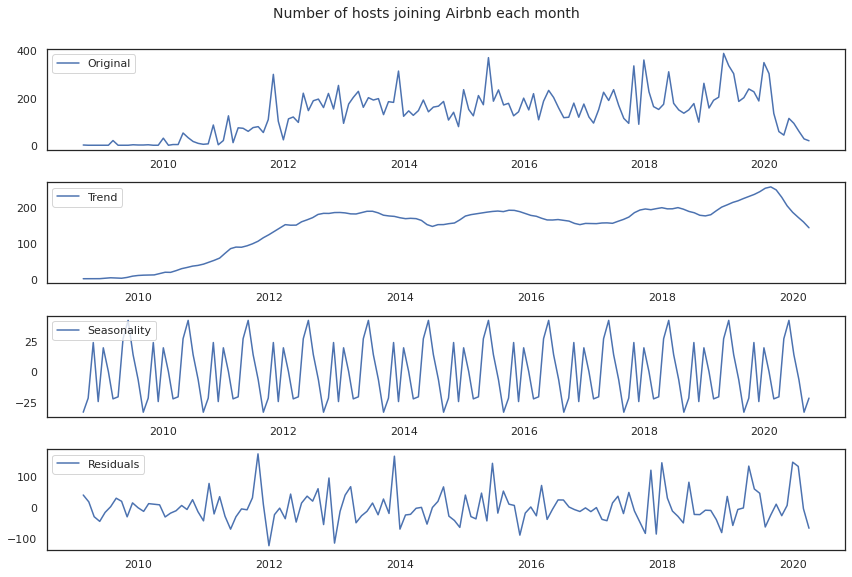

In [2185]:
ts_host_since = pd.DataFrame(df.set_index('host_since').resample('MS').size())
decompose_time_series(ts_host_since, title='Number of hosts joining Airbnb each month')

We notice that more hosts have been joining the platform towards the year end.

Q. How does price change with number of people?

In [2508]:
# df.groupby('accommodates').price.mean().plot(kind='bar') 
# plt.xlabel('No. of people')
# plt.ylabel('Mean price (dollars)')

x = df.groupby('accommodates').price.mean()
fig = go.Figure()
fig.add_trace(go.Bar(x=x.index, y=x.values, marker_color=px.colors.qualitative.Dark24[1]))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     title=dict(
                         font=dict(
                             # family="sans-serif",
                             size=15,
                             color="black"
                         ),
                         text='Mean price'
                     ),
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     title=dict(
                         font=dict(
                             # family="sans-serif",
                             size=15,
                             color="black"
                         ),
                         text='No. of people'
                     ),
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

The optimal number of people to get the best price are 11 or 13. Usually, if you travel in large groups, you will be able to get cheaper accomodation compared to when you travel in small groups. So, try to gather as many friends as you can before travelling. It will be cheaper and more fun.

Q. How much do the houses cost in certain neighbourhoods?

In [2501]:
# df.groupby('neighbourhood_cleansed').price.mean().plot(kind='bar', figsize=(15,5))
# plt.xlabel('Neighbourhood')
# plt.ylabel('Mean price (dollars)')

x = df.groupby('neighbourhood_cleansed').price.mean()
fig = go.Figure()
fig.add_trace(go.Bar(x=x.index, y=x.values, marker_color='#66c56c'))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     title=dict(
                         font=dict(
                             # family="sans-serif",
                             # size=15,
                             color="black"
                         ),
                         text='Mean price'
                     ),
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
#                      tickvals=x.index,
#                      ticktext=x.index,
#                      title=dict(
#                          font=dict(
#                              # family="sans-serif",
#                              size=15,
#                              color="black"
#                          ),
#                          text='No. of people'
#                      ),
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

We notice that certain neighbourhoods are more expensive than others and these are shown both above and below. The expensive neighbourhoods consist of the beach front, urban and central properties. Naturally, we would assume that it is expensive to live in central and urban areas and also areas near the beaches.

In [2641]:
# beach front, urban central neighbourhoods are most expensive
df.groupby('neighbourhood_cleansed').price.mean().sort_values(ascending=False)[:8]

neighbourhood_cleansed
Diagonal Mar i el Front Marítim del Poblenou    160.715385
la Vila Olímpica del Poblenou                   130.323944
la Dreta de l'Eixample                          121.551701
la Marina del Prat Vermell                      117.166667
la Font d'en Fargues                            117.166667
Sant Gervasi - Galvany                          111.452736
Vallvidrera, el Tibidabo i les Planes           106.384615
les Tres Torres                                 101.148148
Name: price, dtype: float64

Q. How has the mean price changed over years?

In [2830]:
# plt.figure(figsize=(10,6))
# sns.boxplot(df.host_since.dt.year, np.log(df.price))

fig = go.Figure()
fig.add_trace(go.Box(x=df.host_since.dt.year, y=np.log(df.price), marker_color='#66c56c'))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     title=dict(
                         font=dict(
                             # family="sans-serif",
                             # size=15,
                             color="black"
                         ),
                         text='Price(log-transformed)'
                     ),
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
#                      tickvals=x.index,
#                      ticktext=x.index,
                     title=dict(
                         font=dict(
                             # family="sans-serif",
                             size=15,
                             color="black"
                         ),
                         text='Years'
                     ),
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

The mean price of properties has remained consistent throughout the years. Although, the lower bound of price was the lowest in 2020. This can be attributed to the decline in people travelling and thus some properties may have been marked at a very cheap price.

Q. What are the factors affecting the price of the homes?

In [2831]:
corrs = df.corr()['price'].sort_values(ascending=False)[1:20]
fig = go.Figure()
fig.add_trace(go.Bar(x=corrs.index, y=corrs.values, marker_color='#23aaff'))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

The most important factors that affect the price are the number of people accomodated, bedrooms, beds, and bathrooms in the home. This is also very intuitive. Other factors include amenities such as TV, air-conditioning, coffee, etc. Also the number of host listings and the area 'Eixample' have an affect on the price.

Since we have our complete data now, let's have a look at the multi collinearity heatmap to see the correlation amongst all the features.

In [2832]:
def multi_collinearity_heatmap(df, figsize=(11,9)):
    
    """
    Creates a heatmap of correlations between features in the df. A figure size can optionally be set.
    """
    
    # Set the style of the visualization
    sns.set(style="white")

    # Create a covariance matrix
    corr = df.corr()

    # Generate a mask the size of our covariance matrix
    mask = np.zeros_like(corr, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=figsize)

    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(220, 10, as_cmap=True)

    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(corr, mask=mask, cmap=cmap, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5}, vmax=corr[corr != 1.0].max().max());

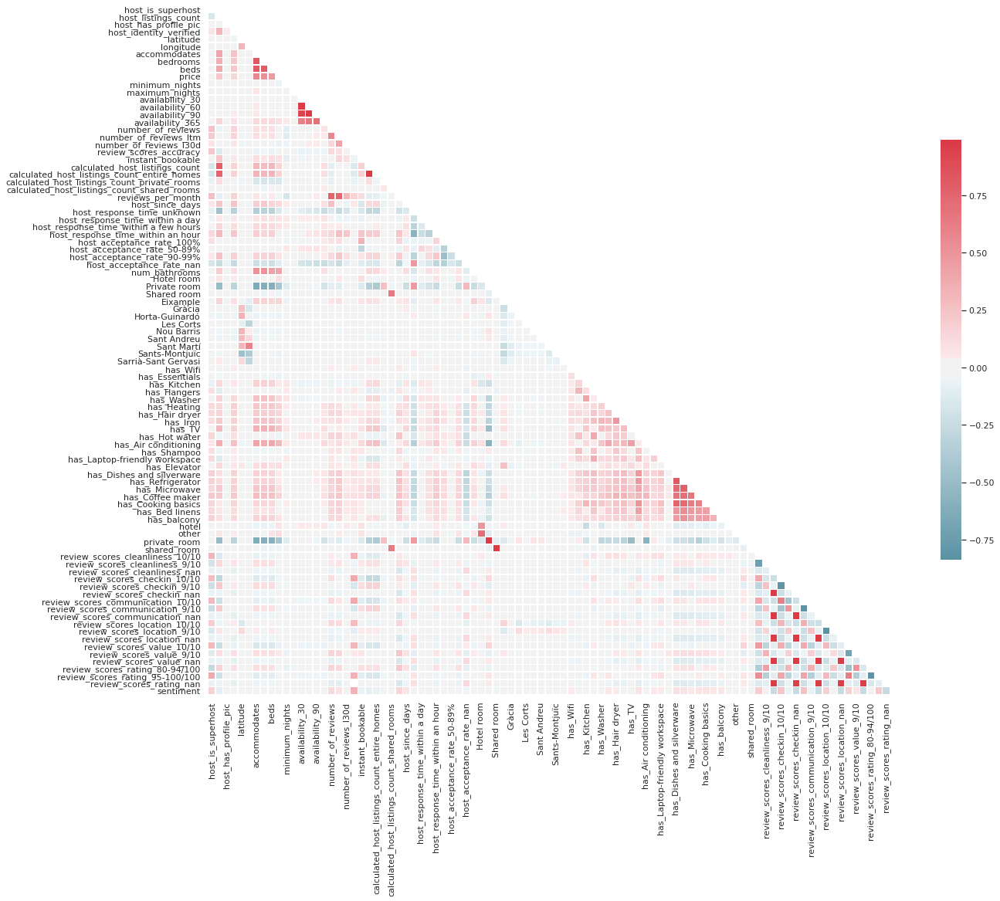

In [2833]:
multi_collinearity_heatmap(df, figsize=(20,20))

In [2834]:
df.shape

(12787, 111)

Now, we extract all the numeric features from our dataframe to create our sets for the price prediction.

In [2598]:
# pd.set_option("display.max_columns", 100)
numerics = df.select_dtypes(include = ['float', 'int', np.uint8]).columns
df[numerics].head()

,host_is_superhost,host_listings_count,host_identity_verified,latitude,longitude,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_accuracy,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,sentiment,host_since_days,host_response_time_unknown,host_response_time_within a day,host_response_time_within a few hours,host_response_time_within an hour,host_acceptance_rate_100%,host_acceptance_rate_50-89%,host_acceptance_rate_90-99%,host_acceptance_rate_nan,num_bathrooms,Hotel room,Private room,Shared room,Eixample,Gràcia,Horta-Guinardó,Les Corts,Nou Barris,Sant Andreu,Sant Martí,Sants-Montjuïc,Sarrià-Sant Gervasi,review_scores_cleanliness_10/10,review_scores_cleanliness_9/10,review_scores_cleanliness_nan,review_scores_checkin_10/10,review_scores_checkin_9/10,review_scores_checkin_nan,review_scores_communication_10/10,review_scores_communication_9/10,review_scores_communication_nan,review_scores_location_10/10,review_scores_location_9/10,review_scores_location_nan,review_scores_value_10/10,review_scores_value_9/10,review_scores_value_nan,review_scores_rating_80-94/100,review_scores_rating_95-100/100,review_scores_rating_nan,has_kitchen,has_balcony,has_Wifi,has_Essentials,has_Kitchen,has_Hair dryer,has_Hangers,has_Heating,has_Iron,has_Washer,has_Hot water,has_TV,has_Shampoo,has_Air conditioning,has_Dishes and silverware,has_Refrigerator,has_Elevator,has_Laptop-friendly workspace,has_Microwave,has_Coffee maker,has_Cooking basics,has_Bed linens,hotel,other,private_room,shared_room
0,0,1.386294,1,41.37973,2.17631,2,0.693147,0.693147,55,3,90,4,23,49,139,2,0,0,2.397895,0,3,1,2,0,0.048790,0.693147,3914.0,0,0,1,0,0,0,1,0,0.693147,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,1,0,1,0,1,1,1,0,0,1,0,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,1,0
1,1,1.945910,1,41.41291,2.22063,6,1.386294,1.791759,180,3,1125,30,60,90,358,52,1,0,2.397895,1,2,2,0,0,0.371564,0.681451,3870.0,0,0,0,1,1,0,0,0,1.098612,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,1,0,0,1,0,1,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,0,0,0,0
2,0,1.791759,1,41.40566,2.17015,6,1.098612,1.386294,109,2,31,0,0,0,0,63,5,0,2.302585,1,5,5,0,0,0.444686,0.619039,3787.0,0,0,0,1,0,0,1,0,0.693147,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0
3,0,1.386294,1,41.37916,2.17535,2,0.693147,0.693147,40,30,240,0,0,0,0,8,0,0,2.197225,0,3,1,2,0,0.058269,0.693147,3914.0,0,0,1,0,0,0,1,0,0.693147,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,0,0,1,0,1,1,1,1,0,1,1,1,0,0,0,1,0
4,0,1.386294,1,41.37978,2.17623,9,1.609438,1.945910,131,4,365,0,0,2,92,149,7,0,2.397895,1,3,1,2,0,0.797507,0.659531,3914.0,0,0,1,0,0,0,1,0,1.386294,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0


In [2599]:
num_vars = df[numerics]

In [2600]:
num_vars.isna().sum().sort_values(ascending=False)

review_scores_accuracy                          254
shared_room                                       0
host_acceptance_rate_90-99%                       0
sentiment                                         0
host_since_days                                   0
host_response_time_unknown                        0
host_response_time_within a day                   0
host_response_time_within a few hours             0
host_response_time_within an hour                 0
host_acceptance_rate_100%                         0
host_acceptance_rate_50-89%                       0
host_acceptance_rate_nan                          0
calculated_host_listings_count_shared_rooms       0
num_bathrooms                                     0
Hotel room                                        0
Private room                                      0
Shared room                                       0
Eixample                                          0
Gràcia                                            0
Horta-Guinar

In [2601]:
# fill nulls with mean
# fill_mean = lambda col: col.fillna(col.mean())
# num_vars = num_vars.apply(fill_mean)
num_vars.dropna(how='any', inplace=True)

Split the numeric set to train and test sets. We also standardize the data so that they can be modelled with ease.

In [2602]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

X = num_vars.drop(['price'], axis=1)
y = num_vars['price']

# Scaling
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

We use gradient boosting trees for our modelling. We use two implementations:

1. Gradient boosting regressor from sklearn.
2. XGBoost Regressor

In [2835]:
# from sklearn.linear_model import LinearRegression
# from sklearn.metrics import r2_score, mean_squared_error

# cols = ['host_is_superhost', 'host_listings_count','minimum_nights', 'maximum_nights', 'accommodates', 'bedrooms', 'beds', 'num_bathrooms', 'Hotel room', 'Private room', 'Shared room',
#        'Eixample', 'Gràcia', 'Horta-Guinardó', 'Les Corts', 'Nou Barris',
#        'Sant Andreu', 'Sant Martí', 'Sants-Montjuïc', 'Sarrià-Sant Gervasi', 'latitude', 'longitude' ]


# model = LinearRegression(normalize=True)

# model.fit(X_train, y_train)
# pred = model.predict(X_test)

# print("r squared:", r2_score(y_test, pred))
# print("mean squared:", mean_squared_error(y_test, pred))

In [2836]:
from sklearn.ensemble import GradientBoostingRegressor

model = GradientBoostingRegressor()

model.fit(X_train, y_train)
pred = model.predict(X_test)

print("r squared:", r2_score(y_test, pred))
print("mean squared:", mean_squared_error(y_test, pred))

r squared: 0.5534614581566428
mean squared: 3049.5192009637613


In [2837]:
from xgboost import XGBRegressor

xgb_model = XGBRegressor(
    max_depth=10,
    n_estimators=1000,
    min_child_weight=0.5, 
    colsample_bytree=0.8, 
    subsample=0.8, 
    eta=0.1,
    seed= 48  #32
)

xgb_model.fit(
    X_train, 
    y_train)

XGBRegressor(colsample_bytree=0.8, eta=0.1, max_depth=10, min_child_weight=0.5,
             n_estimators=1000, seed=48, subsample=0.8)

In [2838]:
xg_pred = xgb_model.predict(X_test)

print("r squared:", r2_score(y_test, xg_pred))
print("mean squared:", mean_squared_error(y_test, xg_pred))

r squared: 0.6427799982707076
mean squared: 2439.5413881741074


We achieve an r squared score of ~0.64 which is not the best but this dataset is quite challenging and has lesser number of entries. If we were to use all these features on other airbnb datasets, we would definitely perform better. Some other airbnb datasets have other important features such as cleaning fees and security, etc. which are important in predicting the price.

Plotting the feature imporatance for the XGBoost model.

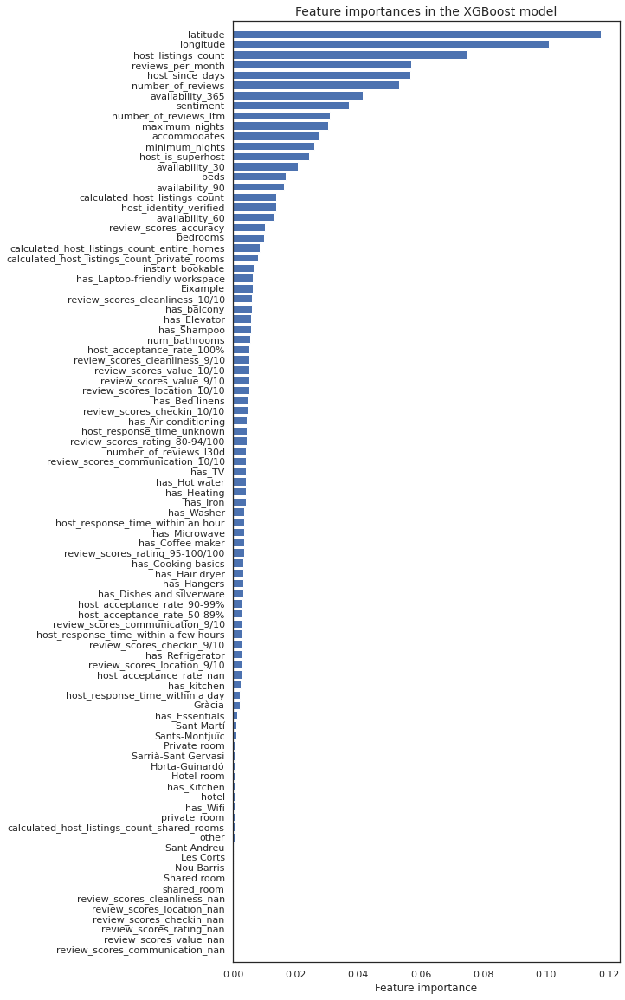

In [2608]:
# Producing a dataframe of feature importances
ft_weights_xgb_reg = pd.DataFrame(xgb_model.feature_importances_, columns=['weight'], index=X_train.columns)
ft_weights_xgb_reg.sort_values('weight', inplace=True)

# Plotting feature importances
plt.figure(figsize=(8,20))
plt.barh(ft_weights_xgb_reg.index, ft_weights_xgb_reg.weight, align='center') 
plt.title("Feature importances in the XGBoost model", fontsize=14)
plt.xlabel("Feature importance")
plt.margins(y=0.01)
plt.show()

The most important features for XGBoost are the location coordinates followed by the host listings, number of reviews, availability, and sentiment, etc.